# AlexNet-based Aircraft Detector Pipeline

This notebook walks through the full workflow for building an Airbus airplane detector on 2560×2560 satellite tiles: downloading the data, exploring its structure, defining helper utilities, fitting an AlexNet-based detection model, and finally validating/inferencing on held-out samples.


In [1]:
from typing import Any, Dict, List, Optional, Sequence, Tuple

import ast
import json
import math
import random
import subprocess
import time
import warnings
from collections import Counter, defaultdict, OrderedDict
from dataclasses import dataclass
from functools import partial
from pathlib import Path
import shutil

import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
import seaborn as sns
import torch
from IPython import display
from PIL import Image, ImageDraw
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms import functional as F
from torchvision.models import AlexNet_Weights
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.ops import box_iou

from alexnet_detector_custom import ClassicAlexNetBackbone, build_alexnet_detector as build_custom_alexnet_detector
from tqdm.auto import tqdm

import zipfile

# Download the dataset if it is empty

In [2]:
DATASET_ID = "airbusgeo/airbus-aircrafts-sample-dataset"
DATA_DIR = Path("dataset")
DATASET_NAME = "airbus-aircrafts-sample-dataset"
DATASET_DIR = DATA_DIR / DATASET_NAME
ZIP_PATH = DATA_DIR / f"{DATASET_NAME}.zip"

if DATASET_DIR.exists():
    print(f"Dataset already available at {DATASET_DIR.resolve()}")
else:
    DATA_DIR.mkdir(parents=True, exist_ok=True)

    print(f"Downloading {DATASET_ID} ...")
    try:
        subprocess.run(
            [
                "kaggle",
                "datasets",
                "download",
                "-d",
                DATASET_ID,
                "-p",
                str(DATA_DIR),
            ],
            check=True,
        )
    except FileNotFoundError as exc:
        raise RuntimeError(
            "Kaggle CLI is not installed or not on PATH."
        ) from exc
    except subprocess.CalledProcessError as exc:
        raise RuntimeError(
            "Failed to download dataset. Ensure Kaggle CLI is authenticated."
        ) from exc

    if not ZIP_PATH.exists():
        raise FileNotFoundError(f"Expected archive {ZIP_PATH} not found after download.")

    print(f"Unzipping {ZIP_PATH} ...")
    with zipfile.ZipFile(ZIP_PATH, "r") as zip_ref:
        zip_ref.extractall(DATASET_DIR)

    ZIP_PATH.unlink()
    print(f"Dataset ready at {DATASET_DIR.resolve()}")



Dataset already available at E:\workspace\ml\NN-Lab2\dataset\airbus-aircrafts-sample-dataset


## Visual sanity check

Verify the dataset download by sampling one of the 2560×2560 tiles.


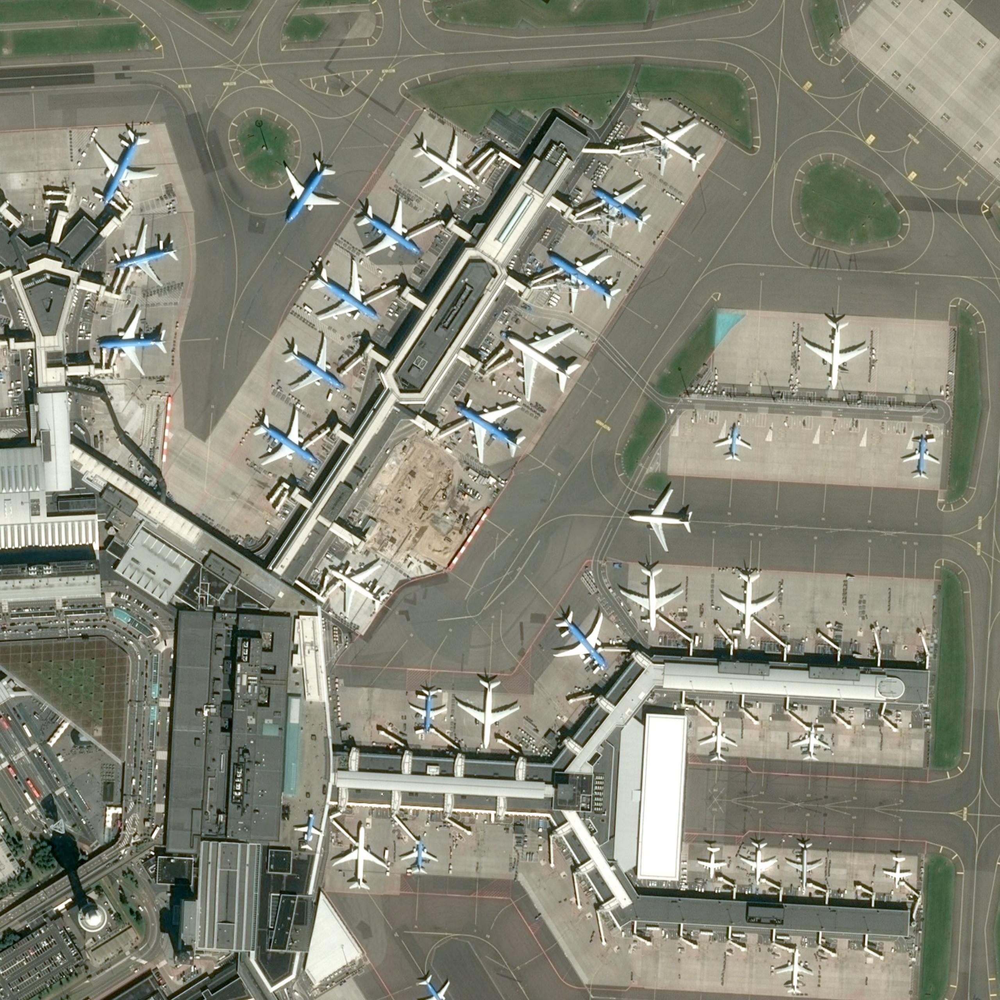

Sample tile: d8873734-016a-4b9d-9b9e-8bc47eb13fef.jpg | resolution: 2560x2560


In [3]:
img_list = sorted(DATASET_DIR.glob("images/*.jpg"))
sample_path = random.choice(img_list)
with Image.open(sample_path) as img:
    width, height = img.size

display.display(display.Image(filename=str(sample_path), embed=True))
print(f"Sample tile: {sample_path.name} | resolution: {width}x{height}")

## Annotation parsing

Load the CSV annotations, convert polygons to bounding boxes, and attach helper columns needed for EDA/training.


In [4]:
ANNOTATIONS_PATH = DATASET_DIR / "annotations.csv"

CLASS_NAME_MAP = {
    "Airplane": "Aircraft",
    "Truncated_airplane": "Truncated_Aircraft",
}
CLASS_TO_IDX = {"Background": 0, "Aircraft": 1, "Truncated_Aircraft": 2}
IDX_TO_CLASS = {idx: name for name, idx in CLASS_TO_IDX.items()}


def parse_geometry(raw_value: str) -> List[Tuple[float, float]]:
    return ast.literal_eval(raw_value.rstrip("\r\n"))


df = pd.read_csv(ANNOTATIONS_PATH, converters={"geometry": parse_geometry})


def polygon_to_bounds(polygon: List[Tuple[float, float]]) -> Tuple[float, float, float, float]:
    arr = np.array(polygon, dtype=np.float32)
    xs, ys = arr[:, 0], arr[:, 1]
    return float(xs.min()), float(ys.min()), float(xs.max()), float(ys.max())


df[["xmin", "ymin", "xmax", "ymax"]] = df["geometry"].apply(
    lambda poly: pd.Series(polygon_to_bounds(poly))
)

df["width"] = df["xmax"] - df["xmin"]
df["height"] = df["ymax"] - df["ymin"]
df["area"] = df["width"] * df["height"]
df["aspect_ratio"] = df["width"] / df["height"]
df["image_path"] = df["image_id"].apply(lambda x: DATASET_DIR / "images" / x)
df["class_name"] = df["class"].map(CLASS_NAME_MAP).fillna("Aircraft")
df["label_id"] = df["class_name"].map(CLASS_TO_IDX).astype(int)

display_df = df.head(5).copy()
display_df["image_path"] = display_df["image_path"].astype(str)
display_df


,id,image_id,geometry,class,xmin,ymin,xmax,ymax,width,height,area,aspect_ratio,image_path,class_name,label_id
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Airplane,135.0,522.0,245.0,600.0,110.0,78.0,8580.0,1.410256,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Airplane,1025.0,284.0,1125.0,384.0,100.0,100.0,10000.0,1.000000,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Airplane,1058.0,1503.0,1130.0,1568.0,72.0,65.0,4680.0,1.107692,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
3,4,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(813, 1518), (885, 1518), (885, 1604), (813, ...",Airplane,813.0,1518.0,885.0,1604.0,72.0,86.0,6192.0,0.837209,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1
4,5,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(594, 938), (657, 938), (657, 1012), (594, 10...",Airplane,594.0,938.0,657.0,1012.0,63.0,74.0,4662.0,0.851351,dataset\airbus-aircrafts-sample-dataset\images...,Aircraft,1


## Exploratory data analysis

Understand how many aircraft exist per tile and how their bounding boxes are distributed before training.


,Unique tiles,Total boxes,Mean boxes/tile,Max boxes/tile,Min boxes/tile
0,103,3425,33.25,92,5


class_name
Aircraft              3316
Truncated_Aircraft     109
Name: count, dtype: int64

,image_id,median_width,median_height,median_area,box_count
85,d9399a45-6745-4e59-8903-90640b2ddf9f.jpg,96.0,101.0,9696.00,92
80,cbd51501-ed0f-411c-b472-df4357cca40c.jpg,67.5,67.0,4522.50,88
36,56e2d3d3-6b16-401f-a300-847272373df5.jpg,69.0,73.0,5037.00,71
34,54b4e42b-3667-4564-b8fa-c23122ca54d5.jpg,69.0,69.0,4761.00,67
60,980b5831-43b7-4adb-9e4b-67d6cff3ef68.jpg,69.0,78.0,5382.00,67
61,996ba764-cd2a-49c0-9c9f-b166207de0ab.jpg,89.5,70.5,6309.75,64
50,7635d63c-6b97-4c9c-a7dc-27773d42ed4c.jpg,110.5,129.5,14309.75,60
100,fc1ab8ce-e531-46ed-b74b-0374cd58cf2a.jpg,113.5,112.5,12768.75,58
45,696b9320-7dbe-4c28-bd07-7a73e7a28e64.jpg,77.5,83.5,6471.25,58
21,3e321b8a-9504-45aa-82b4-16158e28e290.jpg,80.0,83.0,6640.00,57


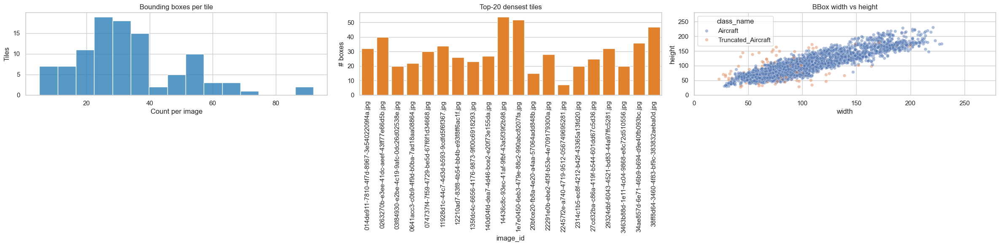

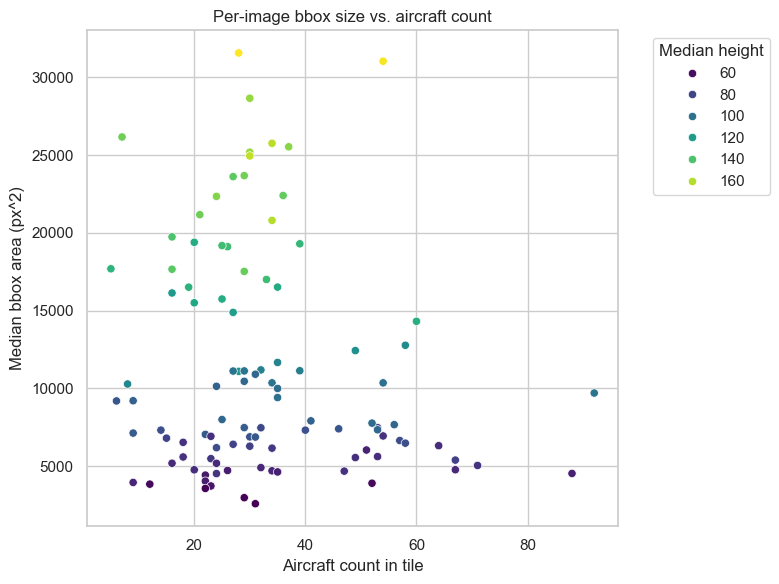

In [5]:
sns.set_theme(style="whitegrid")

num_images = df["image_id"].nunique()
boxes_per_image = df.groupby("image_id").size().astype(int)
class_distribution = df["class_name"].value_counts().rename("count")

summary_table = pd.DataFrame(
    {
        "Unique tiles": [num_images],
        "Total boxes": [len(df)],
        "Mean boxes/tile": [boxes_per_image.mean()],
        "Max boxes/tile": [boxes_per_image.max()],
        "Min boxes/tile": [boxes_per_image.min()],
    }
)
display.display(summary_table.round(2))

display.display(class_distribution)

per_image_box_stats = (
    df.groupby("image_id")
    .agg(
        box_count=("id", "count"),
        min_width=("width", "min"),
        median_width=("width", "median"),
        max_width=("width", "max"),
        min_height=("height", "min"),
        median_height=("height", "median"),
        max_height=("height", "max"),
    )
    .reset_index()
)
per_image_box_stats["median_area"] = per_image_box_stats["median_width"] * per_image_box_stats["median_height"]

fig, axes = plt.subplots(1, 3, figsize=(24, 6))
sns.histplot(boxes_per_image, bins=15, ax=axes[0], color="#1f77b4")
axes[0].set_title("Bounding boxes per tile")
axes[0].set_xlabel("Count per image")
axes[0].set_ylabel("Tiles")

head_counts = boxes_per_image.head(20)
sns.barplot(x=head_counts.index, y=head_counts.values, ax=axes[1], color="#ff7f0e")
axes[1].set_title("Top-20 densest tiles")
axes[1].set_xlabel("image_id")
axes[1].tick_params(axis="x", rotation=90)
axes[1].set_ylabel("# boxes")

sns.scatterplot(
    data=df,
    x="width",
    y="height",
    hue="class_name",
    ax=axes[2],
    alpha=0.45,
    s=30,
)
axes[2].set_title("BBox width vs height")
axes[2].set_xlim(0, df["width"].max() + 50)
axes[2].set_ylim(0, df["height"].max() + 50)
plt.tight_layout()

per_image_melt = per_image_box_stats[["image_id", "median_width", "median_height", "median_area", "box_count"]].copy()
per_image_melt.sort_values("box_count", ascending=False, inplace=True)
display.display(per_image_melt.head(10))

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=per_image_box_stats,
    x="box_count",
    y="median_area",
    hue="median_height",
    palette="viridis",
)
plt.title("Per-image bbox size vs. aircraft count")
plt.xlabel("Aircraft count in tile")
plt.ylabel("Median bbox area (px^2)")
plt.legend(title="Median height", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()


## AlexNet backbone diagnostics

Instantiate a fresh AlexNet feature extractor, count its parameters, and trace the tensor shapes flowing through each major layer to double-check the architecture.


## Helper utilities for the training pipeline

Reusable dataset, augmentation, metric, and training helpers live in this section so the later notebook cells can stay focused on orchestration.


In [6]:
# --- Dataset + utility structures -------------------------------------------------

@dataclass
class AnnotationRecord:
    """Container for all annotations belonging to one satellite tile."""

    image_id: str
    image_path: Path
    boxes: np.ndarray
    labels: np.ndarray
    class_names: List[str]


def build_annotation_records(frame: pd.DataFrame) -> Dict[str, AnnotationRecord]:
    records: Dict[str, AnnotationRecord] = {}
    for image_id, group in frame.groupby("image_id"):
        boxes = group[["xmin", "ymin", "xmax", "ymax"]].values.astype(np.float32)
        labels = group["label_id"].values.astype(np.int64)
        class_names = group["class_name"].tolist()
        image_path = Path(group["image_path"].iloc[0])
        records[image_id] = AnnotationRecord(
            image_id=image_id,
            image_path=image_path,
            boxes=boxes,
            labels=labels,
            class_names=class_names,
        )
    return records


def split_image_ids(
    image_ids: Sequence[str], val_ratio: float = 0.15, test_ratio: float = 0.15, seed: int = 42
) -> Dict[str, List[str]]:
    rng = np.random.default_rng(seed)
    image_ids = np.array(image_ids)
    rng.shuffle(image_ids)
    n_total = len(image_ids)
    n_test = int(n_total * test_ratio)
    n_val = int(n_total * val_ratio)
    test_ids = image_ids[:n_test].tolist()
    val_ids = image_ids[n_test : n_test + n_val].tolist()
    train_ids = image_ids[n_test + n_val :].tolist()
    return {"train": train_ids, "val": val_ids, "test": test_ids}


ALEXNET_WEIGHTS = AlexNet_Weights.IMAGENET1K_V1
ALEXNET_MEAN = ALEXNET_WEIGHTS.transforms().mean
ALEXNET_STD = ALEXNET_WEIGHTS.transforms().std

CLASSIFIER_BACKBONE_WEIGHTS = Path("artifacts") / "alexnet_classifier_weights.pth"
if not CLASSIFIER_BACKBONE_WEIGHTS.exists():
    raise FileNotFoundError(
        f"Expected classifier weights at {CLASSIFIER_BACKBONE_WEIGHTS.resolve()}"
    )


class AirbusDetectionDataset(Dataset):
    """PyTorch dataset that reads Airbus tiles and formats targets for Faster R-CNN."""

    def __init__(
        self,
        records: Dict[str, AnnotationRecord],
        image_ids: Sequence[str],
        image_size: int = 1024,
        is_train: bool = False,
        hflip_prob: float = 0.5,
    ) -> None:
        self.records = records
        self.image_ids = list(image_ids)
        self.image_size = image_size
        self.is_train = is_train
        self.hflip_prob = hflip_prob

    def __len__(self) -> int:
        return len(self.image_ids)

    def _load_image(self, record: AnnotationRecord) -> Image.Image:
        return Image.open(record.image_path).convert("RGB")

    def _resize_boxes(
        self, boxes: torch.Tensor, orig_size: Tuple[int, int], new_size: int
    ) -> torch.Tensor:
        orig_w, orig_h = orig_size
        scale_x = new_size / orig_w
        scale_y = new_size / orig_h
        boxes = boxes.clone()
        boxes[:, [0, 2]] *= scale_x
        boxes[:, [1, 3]] *= scale_y
        return boxes

    def _random_horizontal_flip(
        self, image: Image.Image, boxes: torch.Tensor
    ) -> Tuple[Image.Image, torch.Tensor]:
        if not self.is_train or random.random() > self.hflip_prob:
            return image, boxes
        flipped = image.transpose(Image.FLIP_LEFT_RIGHT)
        img_w = image.width
        boxes = boxes.clone()
        xmin = img_w - boxes[:, 2]
        xmax = img_w - boxes[:, 0]
        boxes[:, 0], boxes[:, 2] = xmin, xmax
        return flipped, boxes

    def __getitem__(self, idx: int) -> Tuple[torch.Tensor, Dict[str, torch.Tensor]]:
        record = self.records[self.image_ids[idx]]
        image = self._load_image(record)
        orig_w, orig_h = image.size

        boxes = torch.as_tensor(record.boxes, dtype=torch.float32)
        labels = torch.as_tensor(record.labels, dtype=torch.int64)

        if self.image_size:
            image = image.resize((self.image_size, self.image_size), Image.BILINEAR)
            boxes = self._resize_boxes(boxes, (orig_w, orig_h), self.image_size)

        image, boxes = self._random_horizontal_flip(image, boxes)

        tensor_image = F.to_tensor(image)
        tensor_image = F.normalize(tensor_image, mean=ALEXNET_MEAN, std=ALEXNET_STD)

        target: Dict[str, torch.Tensor] = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([idx], dtype=torch.int64),
            "area": (boxes[:, 2] - boxes[:, 0]) * (boxes[:, 3] - boxes[:, 1]),
            "iscrowd": torch.zeros((len(boxes),), dtype=torch.int64),
            "orig_size": torch.tensor([orig_h, orig_w]),
        }
        return tensor_image, target


def detection_collate(batch: Sequence[Tuple[torch.Tensor, Dict[str, torch.Tensor]]]):
    images, targets = zip(*batch)
    return list(images), list(targets)


# --- Training/evaluation helpers -------------------------------------------------

def seed_everything(seed: int = 42) -> None:
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)


class AverageMeter:
    """Track running averages for training losses."""

    def __init__(self) -> None:
        self.reset()

    def reset(self) -> None:
        self.count = 0
        self.total = 0.0

    def update(self, value: float, n: int = 1) -> None:
        self.total += value * n
        self.count += n

    @property
    def avg(self) -> float:
        return self.total / max(self.count, 1)


class EarlyStopping:
    def __init__(self, patience: int = 3, delta: float = 0.0) -> None:
        self.patience = patience
        self.delta = delta
        self.best_score: Optional[float] = None
        self.bad_epochs = 0

    def step(self, metric: float) -> bool:
        if self.best_score is None or metric > self.best_score + self.delta:
            self.best_score = metric
            self.bad_epochs = 0
            return False
        self.bad_epochs += 1
        return self.bad_epochs > self.patience


class CheckpointManager:
    def __init__(self, path: Path) -> None:
        self.path = path

    def save(self, model_state: Dict[str, Any], optimizer_state: Dict[str, Any], epoch: int, metric: float) -> None:
        torch.save(
            {
                "epoch": epoch,
                "metric": metric,
                "model_state": model_state,
                "optimizer_state": optimizer_state,
            },
            self.path,
        )


class HistoryLogger:
    def __init__(self) -> None:
        self.rows: List[Dict[str, float]] = []

    def log(self, **kwargs: float) -> None:
        self.rows.append(kwargs)

    def to_frame(self) -> pd.DataFrame:
        return pd.DataFrame(self.rows)


def train_one_epoch(
    model: nn.Module,
    loader: DataLoader,
    optimizer: torch.optim.Optimizer,
    device: torch.device,
) -> float:
    model.train()
    loss_meter = AverageMeter()
    for images, targets in tqdm(loader, desc="Train", leave=False):
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        loss = sum(loss_dict.values())

        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        optimizer.step()

        loss_meter.update(loss.item(), n=len(images))
    return loss_meter.avg


def validate_one_epoch(
    model: nn.Module,
    loader: DataLoader,
    device: torch.device,
) -> float:
    prev_state = model.training
    model.train()
    loss_meter = AverageMeter()
    with torch.no_grad():
        for images, targets in tqdm(loader, desc="Val", leave=False):
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) if torch.is_tensor(v) else v for k, v in t.items()} for t in targets]
            loss_dict = model(images, targets)
            loss = sum(loss_dict.values())
            loss_meter.update(loss.item(), n=len(images))
    model.train(prev_state)
    return loss_meter.avg


# --- Metric helpers --------------------------------------------------------------

def average_precision_50(
    pred_boxes: torch.Tensor,
    pred_scores: torch.Tensor,
    gt_boxes: torch.Tensor,
    iou_threshold: float = 0.5,
) -> float:
    if gt_boxes.numel() == 0:
        return 1.0 if pred_boxes.numel() == 0 else 0.0
    if pred_boxes.numel() == 0:
        return 0.0

    order = torch.argsort(pred_scores, descending=True)
    pred_boxes = pred_boxes[order]
    pred_scores = pred_scores[order]

    ious = box_iou(pred_boxes, gt_boxes)
    gt_matched = torch.zeros(len(gt_boxes), dtype=torch.bool)

    tps = []
    fps = []
    for pred_idx in range(len(pred_boxes)):
        iou_vals = ious[pred_idx]
        best_iou, best_gt = torch.max(iou_vals, dim=0)
        if best_iou >= iou_threshold and not gt_matched[best_gt]:
            gt_matched[best_gt] = True
            tps.append(1)
            fps.append(0)
        else:
            tps.append(0)
            fps.append(1)

    tps = np.cumsum(tps)
    fps = np.cumsum(fps)
    precisions = tps / np.maximum(tps + fps, 1e-6)
    recalls = tps / len(gt_boxes)
    ap = np.trapezoid(precisions, recalls)
    return float(ap)


def evaluate_detector(
    model: nn.Module,
    loader: DataLoader,
    device: torch.device,
    score_threshold: float = 0.4,
    iou_threshold: float = 0.5,
) -> Dict[str, float]:
    prev_state = model.training
    model.eval()
    aps = []
    precisions = []
    recalls = []
    detections_per_img: List[int] = []
    kept_score_means: List[float] = []
    with torch.no_grad():
        for images, targets in tqdm(loader, desc="Eval", leave=False):
            images = [img.to(device) for img in images]
            outputs = model(images)
            for output, target in zip(outputs, targets):
                keep = output["scores"] >= score_threshold
                kept_count = int(keep.sum().item())
                detections_per_img.append(kept_count)

                kept_boxes = output["boxes"][keep]
                kept_scores = output["scores"][keep]
                if kept_scores.numel():
                    kept_score_means.append(float(kept_scores.mean().item()))

                pred_boxes = kept_boxes.cpu()
                pred_scores = kept_scores.cpu()
                gt_boxes = target["boxes"].cpu()
                ap = average_precision_50(pred_boxes, pred_scores, gt_boxes, iou_threshold)
                aps.append(ap)

                ious = box_iou(pred_boxes, gt_boxes) if pred_boxes.numel() and gt_boxes.numel() else torch.zeros((len(pred_boxes), len(gt_boxes)))
                matches = (ious >= iou_threshold).any(dim=1).sum().item() if gt_boxes.numel() else 0
                precisions.append(matches / max(len(pred_boxes), 1))
                recalls.append(matches / max(len(gt_boxes), 1))
    model.train(prev_state)
    num_images = len(detections_per_img)
    detection_coverage = (
        sum(1 for count in detections_per_img if count > 0) / num_images if num_images else 0.0
    )
    avg_detections = float(np.mean(detections_per_img)) if detections_per_img else 0.0
    mean_score = float(np.mean(kept_score_means)) if kept_score_means else 0.0
    return {
        "mAP@0.5": float(np.mean(aps)) if aps else 0.0,
        "precision": float(np.mean(precisions)) if precisions else 0.0,
        "recall": float(np.mean(recalls)) if recalls else 0.0,
        "detections_per_image": avg_detections,
        "detection_coverage": detection_coverage,
        "mean_score": mean_score,
    }



In [7]:
temp_backbone = ClassicAlexNetBackbone(trainable_layers=2)
total_params = sum(p.numel() for p in temp_backbone.parameters())
trainable_params = sum(p.numel() for p in temp_backbone.parameters() if p.requires_grad)
print(f"Total parameters: {total_params:,}")
print(f"Trainable parameters: {trainable_params:,}")

layer_shapes: List[Dict[str, Any]] = []
hooks = []
TEST_INPUT_RES = 512


def record_hook(name: str):
    def hook(module, inputs, output):
        if isinstance(output, torch.Tensor):
            shape = tuple(output.shape)
        elif isinstance(output, (list, tuple)):
            shape = [tuple(o.shape) for o in output if isinstance(o, torch.Tensor)]
        else:
            shape = type(output).__name__
        layer_shapes.append({"layer": name, "type": module.__class__.__name__, "output_shape": shape})

    return hook


for name, module in temp_backbone.named_modules():
    if name and isinstance(module, (nn.Conv2d, nn.MaxPool2d, nn.AdaptiveAvgPool2d, nn.ReLU)):
        hooks.append(module.register_forward_hook(record_hook(name)))

with torch.no_grad():
    dummy = torch.zeros(1, 3, TEST_INPUT_RES, TEST_INPUT_RES)
    _ = temp_backbone(dummy)

for hook in hooks:
    hook.remove()

summary_df = pd.DataFrame(layer_shapes)
display.display(summary_df)



Total parameters: 3,747,200
Trainable parameters: 2,212,480


,layer,type,output_shape
0,blocks.0.0,Conv2d,"(1, 96, 127, 127)"
1,blocks.0.1,ReLU,"(1, 96, 127, 127)"
2,blocks.0.2,MaxPool2d,"(1, 96, 63, 63)"
3,blocks.1.0,Conv2d,"(1, 256, 63, 63)"
4,blocks.1.1,ReLU,"(1, 256, 63, 63)"
5,blocks.1.2,MaxPool2d,"(1, 256, 31, 31)"
6,blocks.2.0,Conv2d,"(1, 384, 31, 31)"
7,blocks.2.1,ReLU,"(1, 384, 31, 31)"
8,blocks.3.0,Conv2d,"(1, 384, 31, 31)"
9,blocks.3.1,ReLU,"(1, 384, 31, 31)"


## Train/validation/test splits and loaders

Create per-image records, stratify them into splits, and wrap everything with PyTorch dataloaders.


In [8]:
seed_everything(42)

records = build_annotation_records(df)
image_ids = sorted(records.keys())
splits = split_image_ids(image_ids, val_ratio=0.2, test_ratio=0.1, seed=42)

IMAGE_SIZE = 1024
BATCH_SIZE = 2
NUM_WORKERS = 0

train_dataset = AirbusDetectionDataset(records, splits["train"], image_size=IMAGE_SIZE, is_train=True)
val_dataset = AirbusDetectionDataset(records, splits["val"], image_size=IMAGE_SIZE, is_train=False)
test_dataset = AirbusDetectionDataset(records, splits["test"], image_size=IMAGE_SIZE, is_train=False)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)
test_loader = DataLoader(
    test_dataset,
    batch_size=1,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=detection_collate,
)

split_summary = {
    split: {
        "tiles": len(ids),
        "boxes": sum(len(records[i].boxes) for i in ids),
    }
    for split, ids in splits.items()
}
pd.DataFrame(split_summary).T


,tiles,boxes
train,73,2429
val,20,691
test,10,305


## Training the AlexNet detector with Optuna

Use Optuna to explore optimizer settings (learning rate, weight decay, optimizer type), train for a handful of epochs with early stopping, and log/visualize the history.


In [11]:
if torch.cuda.is_available():
    device = torch.device("cuda")
elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"Using device: {device}")

MAX_EPOCHS = 50
N_TRIALS = 5
PATIENCE = 6
TRAINABLE_BACKBONE_LAYERS = 4 # was 2
EVAL_SCORE_THRESHOLD = 0.4  # relaxed threshold so early epochs still log signal was 0.15
ARTIFACT_DIR = Path("artifacts")
ARTIFACT_DIR.mkdir(parents=True, exist_ok=True)
BEST_MODEL_PATH = ARTIFACT_DIR / "alexnet_custom_detector_best.pth"

best_trial_store = {"metric": -np.inf, "history": None, "params": None}


def build_model_instance() -> nn.Module:
    return build_custom_alexnet_detector(
        num_classes=len(CLASS_TO_IDX),
        classifier_weights=CLASSIFIER_BACKBONE_WEIGHTS,
        freeze_backbone=False,
        trainable_layers=TRAINABLE_BACKBONE_LAYERS,
    )


def build_param_groups(
    model: nn.Module,
    base_lr: float,
    head_lr_multiplier: float,
    backbone_lr_multiplier: float,
) -> List[Dict[str, Any]]:
    head_params: List[torch.nn.Parameter] = []
    backbone_params: List[torch.nn.Parameter] = []
    other_params: List[torch.nn.Parameter] = []
    for name, param in model.named_parameters():
        if not param.requires_grad:
            continue
        if name.startswith(("roi_heads", "rpn")):
            head_params.append(param)
        elif name.startswith("backbone"):
            backbone_params.append(param)
        else:
            other_params.append(param)

    param_groups: List[Dict[str, Any]] = []
    if other_params:
        param_groups.append({"params": other_params})
    if backbone_params:
        param_groups.append({"params": backbone_params, "lr": base_lr * backbone_lr_multiplier})
    if head_params:
        param_groups.append({"params": head_params, "lr": base_lr * head_lr_multiplier})
    if not param_groups:
        raise ValueError("No trainable parameters found for optimizer.")
    return param_groups


def make_optimizer(trial: optuna.Trial, model: nn.Module) -> torch.optim.Optimizer:
    lr = trial.suggest_float("lr", 1e-4, 1e-3, log=True) # was 3e-6, 1e-3
    weight_decay = trial.suggest_float("weight_decay", 1e-6, 1e-3, log=True) # was 1e-6, 1e-2 
    head_lr_multiplier = trial.suggest_float("head_lr_multiplier", 1.5, 5) # was 1.0, 5.0
    backbone_lr_multiplier = trial.suggest_float("backbone_lr_multiplier", 0.05, 0.4) # was 0.05, 0.5
    param_groups = build_param_groups(model, lr, head_lr_multiplier, backbone_lr_multiplier)
    
    return torch.optim.AdamW(param_groups, lr=lr, weight_decay=weight_decay)


def objective(trial: optuna.Trial) -> float:
    model = build_model_instance().to(device)
    optimizer = make_optimizer(trial, model)
    early_stopper = EarlyStopping(patience=PATIENCE, delta=1e-3)
    history = HistoryLogger()
    checkpoint_path = ARTIFACT_DIR / f"trial_{trial.number}_best.pth"
    history_path = ARTIFACT_DIR / f"trial_{trial.number}_history.csv"
    checkpoint = CheckpointManager(checkpoint_path)
    best_metric = -np.inf

    for epoch in range(1, MAX_EPOCHS + 1):
        train_loss = train_one_epoch(model, train_loader, optimizer, device)
        val_loss = validate_one_epoch(model, val_loader, device)
        val_metrics = evaluate_detector(
            model,
            val_loader,
            device,
            score_threshold=EVAL_SCORE_THRESHOLD,
        )
        metric = val_metrics["mAP@0.5"]

        history.log(
            epoch=epoch,
            train_loss=train_loss,
            val_loss=val_loss,
            map50=val_metrics["mAP@0.5"],
            precision=val_metrics["precision"],
            recall=val_metrics["recall"],
            detections_per_image=val_metrics["detections_per_image"],
            detection_coverage=val_metrics["detection_coverage"],
            mean_score=val_metrics["mean_score"],
        )

        print(
            f"[trial {trial.number}] epoch {epoch:02d}/{MAX_EPOCHS} "
            f"train_loss={train_loss:.3f} val_loss={val_loss:.3f} "
            f"map50={val_metrics['mAP@0.5']:.3f} precision={val_metrics['precision']:.3f} "
            f"recall={val_metrics['recall']:.3f} dets/img={val_metrics['detections_per_image']:.2f} "
            f"coverage={val_metrics['detection_coverage']*100:.1f}% score={val_metrics['mean_score']:.3f}",
            flush=True,
        )

        if metric > best_metric:
            best_metric = metric
            checkpoint.save(model.state_dict(), optimizer.state_dict(), epoch, metric)

        trial.report(metric, epoch)
        if trial.should_prune():
            raise optuna.TrialPruned()

        if early_stopper.step(metric):
            print(f"Early stopping triggered on epoch {epoch}")
            break

    history_df = history.to_frame()
    history_df.to_csv(history_path, index=False)

    global best_trial_store
    if best_metric > best_trial_store["metric"]:
        best_trial_store["metric"] = best_metric
        best_trial_store["history"] = history_df
        best_trial_store["params"] = trial.params
        shutil.copy(checkpoint_path, BEST_MODEL_PATH)

    return best_metric


study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=N_TRIALS)

print("Best trial:", study.best_trial.number)
print("Best params:", study.best_params)
print("Best mAP@0.5:", study.best_value)

best_history_df = best_trial_store["history"] if best_trial_store["history"] is not None else pd.DataFrame()
best_history_df


[I 2025-11-28 22:40:33,367] A new study created in memory with name: no-name-b0316400-59f1-4c5e-8918-d62941dfdc4c


Using device: cuda


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 01/50 train_loss=1.016 val_loss=0.892 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 02/50 train_loss=0.754 val_loss=0.773 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 03/50 train_loss=0.734 val_loss=0.744 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 04/50 train_loss=0.745 val_loss=0.842 map50=0.023 precision=0.076 recall=0.178 dets/img=68.40 coverage=100.0% score=0.466


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 05/50 train_loss=0.748 val_loss=0.860 map50=0.036 precision=0.149 recall=0.203 dets/img=40.75 coverage=100.0% score=0.485


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 06/50 train_loss=0.759 val_loss=0.903 map50=0.009 precision=0.145 recall=0.021 dets/img=2.45 coverage=70.0% score=0.460


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 07/50 train_loss=0.771 val_loss=0.828 map50=0.025 precision=0.212 recall=0.085 dets/img=10.65 coverage=100.0% score=0.451


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 08/50 train_loss=0.747 val_loss=0.825 map50=0.059 precision=0.161 recall=0.243 dets/img=45.65 coverage=100.0% score=0.531


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 09/50 train_loss=0.757 val_loss=0.831 map50=0.057 precision=0.174 recall=0.157 dets/img=26.90 coverage=100.0% score=0.503


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 10/50 train_loss=0.739 val_loss=0.814 map50=0.094 precision=0.167 recall=0.356 dets/img=69.50 coverage=100.0% score=0.520


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 11/50 train_loss=0.737 val_loss=0.855 map50=0.097 precision=0.196 recall=0.347 dets/img=58.25 coverage=100.0% score=0.561


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 12/50 train_loss=0.725 val_loss=0.905 map50=0.097 precision=0.183 recall=0.315 dets/img=54.30 coverage=100.0% score=0.547


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 13/50 train_loss=0.723 val_loss=0.840 map50=0.100 precision=0.170 recall=0.338 dets/img=66.95 coverage=100.0% score=0.540


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 14/50 train_loss=0.717 val_loss=0.893 map50=0.140 precision=0.178 recall=0.421 dets/img=74.30 coverage=100.0% score=0.563


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 15/50 train_loss=0.691 val_loss=1.041 map50=0.124 precision=0.225 recall=0.340 dets/img=50.70 coverage=100.0% score=0.584


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 16/50 train_loss=0.704 val_loss=0.883 map50=0.142 precision=0.204 recall=0.463 dets/img=74.85 coverage=100.0% score=0.564


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 17/50 train_loss=0.679 val_loss=0.887 map50=0.158 precision=0.235 recall=0.403 dets/img=65.50 coverage=100.0% score=0.620


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 18/50 train_loss=0.660 val_loss=0.882 map50=0.155 precision=0.214 recall=0.393 dets/img=63.00 coverage=100.0% score=0.574


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 19/50 train_loss=0.671 val_loss=0.871 map50=0.169 precision=0.193 recall=0.483 dets/img=81.25 coverage=100.0% score=0.607


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 20/50 train_loss=0.653 val_loss=0.970 map50=0.169 precision=0.203 recall=0.510 dets/img=80.30 coverage=100.0% score=0.665


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 21/50 train_loss=0.644 val_loss=0.887 map50=0.191 precision=0.204 recall=0.487 dets/img=77.75 coverage=100.0% score=0.597


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 22/50 train_loss=0.637 val_loss=0.912 map50=0.167 precision=0.222 recall=0.420 dets/img=67.05 coverage=100.0% score=0.600


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 23/50 train_loss=0.626 val_loss=1.029 map50=0.172 precision=0.264 recall=0.409 dets/img=52.60 coverage=100.0% score=0.608


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 24/50 train_loss=0.629 val_loss=0.914 map50=0.209 precision=0.190 recall=0.509 dets/img=87.05 coverage=100.0% score=0.673


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 25/50 train_loss=0.612 val_loss=1.046 map50=0.193 precision=0.228 recall=0.486 dets/img=73.05 coverage=100.0% score=0.677


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 26/50 train_loss=0.605 val_loss=0.987 map50=0.206 precision=0.211 recall=0.447 dets/img=75.35 coverage=100.0% score=0.658


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 27/50 train_loss=0.601 val_loss=0.957 map50=0.188 precision=0.219 recall=0.423 dets/img=73.10 coverage=100.0% score=0.643


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 28/50 train_loss=0.597 val_loss=0.911 map50=0.206 precision=0.192 recall=0.457 dets/img=80.25 coverage=100.0% score=0.630


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 29/50 train_loss=0.588 val_loss=1.010 map50=0.198 precision=0.224 recall=0.494 dets/img=75.45 coverage=100.0% score=0.695


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 30/50 train_loss=0.577 val_loss=1.114 map50=0.216 precision=0.263 recall=0.480 dets/img=69.45 coverage=100.0% score=0.644


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 31/50 train_loss=0.581 val_loss=1.054 map50=0.222 precision=0.232 recall=0.468 dets/img=71.70 coverage=100.0% score=0.667


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 32/50 train_loss=0.571 val_loss=1.077 map50=0.218 precision=0.262 recall=0.498 dets/img=67.00 coverage=100.0% score=0.658


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 33/50 train_loss=0.563 val_loss=1.047 map50=0.221 precision=0.235 recall=0.470 dets/img=71.90 coverage=100.0% score=0.663


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 34/50 train_loss=0.553 val_loss=1.061 map50=0.224 precision=0.217 recall=0.472 dets/img=73.25 coverage=100.0% score=0.651


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 35/50 train_loss=0.547 val_loss=1.111 map50=0.225 precision=0.252 recall=0.477 dets/img=68.35 coverage=100.0% score=0.677


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 36/50 train_loss=0.541 val_loss=1.093 map50=0.249 precision=0.228 recall=0.531 dets/img=79.00 coverage=100.0% score=0.712


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 37/50 train_loss=0.542 val_loss=1.006 map50=0.235 precision=0.235 recall=0.505 dets/img=75.30 coverage=100.0% score=0.653


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 38/50 train_loss=0.540 val_loss=1.104 map50=0.232 precision=0.237 recall=0.469 dets/img=70.70 coverage=100.0% score=0.644


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 39/50 train_loss=0.536 val_loss=1.204 map50=0.215 precision=0.256 recall=0.441 dets/img=62.40 coverage=100.0% score=0.698


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 40/50 train_loss=0.520 val_loss=1.107 map50=0.232 precision=0.232 recall=0.506 dets/img=74.90 coverage=100.0% score=0.708


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 41/50 train_loss=0.513 val_loss=1.165 map50=0.217 precision=0.237 recall=0.477 dets/img=71.20 coverage=100.0% score=0.702


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 42/50 train_loss=0.530 val_loss=1.090 map50=0.225 precision=0.235 recall=0.466 dets/img=72.70 coverage=100.0% score=0.691


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 0] epoch 43/50 train_loss=0.506 val_loss=1.207 map50=0.218 precision=0.284 recall=0.475 dets/img=61.65 coverage=100.0% score=0.693


[I 2025-11-28 22:48:01,184] Trial 0 finished with value: 0.24930891754875573 and parameters: {'lr': 0.00031548045232174314, 'weight_decay': 1.4102941019501312e-06, 'head_lr_multiplier': 3.7451944897027056, 'backbone_lr_multiplier': 0.3033111774548976}. Best is trial 0 with value: 0.24930891754875573.


Early stopping triggered on epoch 43


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 01/50 train_loss=1.023 val_loss=0.940 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 02/50 train_loss=0.764 val_loss=0.810 map50=0.000 precision=0.025 recall=0.002 dets/img=0.10 coverage=5.0% score=0.414


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 03/50 train_loss=0.745 val_loss=0.816 map50=0.005 precision=0.042 recall=0.013 dets/img=4.35 coverage=60.0% score=0.418


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 04/50 train_loss=0.746 val_loss=0.850 map50=0.010 precision=0.059 recall=0.048 dets/img=18.15 coverage=90.0% score=0.475


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 05/50 train_loss=0.760 val_loss=0.812 map50=0.014 precision=0.072 recall=0.072 dets/img=23.45 coverage=90.0% score=0.470


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 06/50 train_loss=0.752 val_loss=0.879 map50=0.016 precision=0.175 recall=0.083 dets/img=17.60 coverage=95.0% score=0.486


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 07/50 train_loss=0.779 val_loss=0.851 map50=0.011 precision=0.155 recall=0.046 dets/img=7.65 coverage=85.0% score=0.488


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 08/50 train_loss=0.764 val_loss=0.910 map50=0.019 precision=0.128 recall=0.100 dets/img=21.35 coverage=90.0% score=0.499


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 09/50 train_loss=0.767 val_loss=0.924 map50=0.046 precision=0.154 recall=0.215 dets/img=44.05 coverage=100.0% score=0.529


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 10/50 train_loss=0.761 val_loss=0.870 map50=0.034 precision=0.143 recall=0.143 dets/img=27.20 coverage=95.0% score=0.501


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 11/50 train_loss=0.764 val_loss=0.875 map50=0.051 precision=0.138 recall=0.227 dets/img=52.25 coverage=100.0% score=0.516


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 12/50 train_loss=0.755 val_loss=0.862 map50=0.040 precision=0.117 recall=0.198 dets/img=40.50 coverage=100.0% score=0.505


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 13/50 train_loss=0.763 val_loss=0.909 map50=0.064 precision=0.156 recall=0.311 dets/img=61.25 coverage=100.0% score=0.564


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 14/50 train_loss=0.736 val_loss=0.859 map50=0.055 precision=0.183 recall=0.230 dets/img=39.50 coverage=100.0% score=0.537


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 15/50 train_loss=0.734 val_loss=0.870 map50=0.076 precision=0.183 recall=0.286 dets/img=50.55 coverage=100.0% score=0.532


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 16/50 train_loss=0.722 val_loss=0.903 map50=0.076 precision=0.162 recall=0.269 dets/img=54.20 coverage=100.0% score=0.534


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 17/50 train_loss=0.711 val_loss=0.875 map50=0.087 precision=0.170 recall=0.328 dets/img=60.65 coverage=100.0% score=0.548


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 18/50 train_loss=0.704 val_loss=0.850 map50=0.078 precision=0.143 recall=0.338 dets/img=76.75 coverage=100.0% score=0.549


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 19/50 train_loss=0.727 val_loss=0.875 map50=0.081 precision=0.150 recall=0.336 dets/img=73.45 coverage=100.0% score=0.561


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 20/50 train_loss=0.707 val_loss=1.010 map50=0.086 precision=0.184 recall=0.301 dets/img=49.35 coverage=100.0% score=0.578


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 21/50 train_loss=0.707 val_loss=0.902 map50=0.104 precision=0.157 recall=0.374 dets/img=75.25 coverage=100.0% score=0.588


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 22/50 train_loss=0.680 val_loss=0.922 map50=0.099 precision=0.148 recall=0.385 dets/img=80.40 coverage=100.0% score=0.581


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 23/50 train_loss=0.673 val_loss=0.929 map50=0.099 precision=0.162 recall=0.359 dets/img=67.90 coverage=100.0% score=0.597


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 24/50 train_loss=0.660 val_loss=0.989 map50=0.095 precision=0.184 recall=0.308 dets/img=55.60 coverage=100.0% score=0.597


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 25/50 train_loss=0.652 val_loss=0.891 map50=0.104 precision=0.160 recall=0.350 dets/img=67.10 coverage=100.0% score=0.581


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 26/50 train_loss=0.652 val_loss=0.975 map50=0.107 precision=0.168 recall=0.380 dets/img=72.15 coverage=100.0% score=0.613


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 27/50 train_loss=0.656 val_loss=0.994 map50=0.099 precision=0.176 recall=0.353 dets/img=68.30 coverage=100.0% score=0.576


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 28/50 train_loss=0.638 val_loss=1.014 map50=0.129 precision=0.195 recall=0.362 dets/img=58.10 coverage=100.0% score=0.588


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 29/50 train_loss=0.627 val_loss=1.065 map50=0.100 precision=0.183 recall=0.313 dets/img=56.80 coverage=100.0% score=0.575


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 30/50 train_loss=0.652 val_loss=1.055 map50=0.117 precision=0.185 recall=0.360 dets/img=61.25 coverage=100.0% score=0.596


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 31/50 train_loss=0.619 val_loss=1.017 map50=0.117 precision=0.184 recall=0.375 dets/img=67.40 coverage=100.0% score=0.600


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 32/50 train_loss=0.612 val_loss=0.966 map50=0.128 precision=0.162 recall=0.444 dets/img=86.10 coverage=100.0% score=0.640


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 33/50 train_loss=0.602 val_loss=1.011 map50=0.129 precision=0.210 recall=0.345 dets/img=58.55 coverage=100.0% score=0.601


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 34/50 train_loss=0.602 val_loss=1.120 map50=0.138 precision=0.205 recall=0.345 dets/img=56.95 coverage=100.0% score=0.609


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 35/50 train_loss=0.595 val_loss=1.015 map50=0.135 precision=0.188 recall=0.375 dets/img=66.60 coverage=100.0% score=0.611


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 36/50 train_loss=0.583 val_loss=1.058 map50=0.142 precision=0.201 recall=0.405 dets/img=69.55 coverage=100.0% score=0.633


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 37/50 train_loss=0.585 val_loss=1.089 map50=0.127 precision=0.190 recall=0.361 dets/img=65.20 coverage=100.0% score=0.639


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 38/50 train_loss=0.585 val_loss=1.096 map50=0.145 precision=0.182 recall=0.379 dets/img=72.10 coverage=100.0% score=0.644


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 39/50 train_loss=0.560 val_loss=1.177 map50=0.143 precision=0.228 recall=0.361 dets/img=54.20 coverage=100.0% score=0.652


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 40/50 train_loss=0.568 val_loss=1.096 map50=0.134 precision=0.180 recall=0.389 dets/img=74.50 coverage=100.0% score=0.619


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 41/50 train_loss=0.560 val_loss=1.145 map50=0.145 precision=0.190 recall=0.397 dets/img=73.75 coverage=100.0% score=0.664


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 42/50 train_loss=0.577 val_loss=1.230 map50=0.155 precision=0.220 recall=0.357 dets/img=55.35 coverage=100.0% score=0.644


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 43/50 train_loss=0.554 val_loss=1.121 map50=0.128 precision=0.202 recall=0.375 dets/img=68.70 coverage=100.0% score=0.661


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 44/50 train_loss=0.543 val_loss=1.238 map50=0.157 precision=0.239 recall=0.375 dets/img=59.45 coverage=100.0% score=0.658


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 45/50 train_loss=0.528 val_loss=1.228 map50=0.146 precision=0.221 recall=0.344 dets/img=52.85 coverage=100.0% score=0.646


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 46/50 train_loss=0.537 val_loss=1.303 map50=0.149 precision=0.222 recall=0.337 dets/img=53.90 coverage=100.0% score=0.649


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 47/50 train_loss=0.528 val_loss=1.210 map50=0.147 precision=0.212 recall=0.392 dets/img=64.85 coverage=100.0% score=0.666


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 48/50 train_loss=0.524 val_loss=1.260 map50=0.158 precision=0.228 recall=0.387 dets/img=57.30 coverage=100.0% score=0.646


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 49/50 train_loss=0.515 val_loss=1.234 map50=0.155 precision=0.221 recall=0.393 dets/img=64.50 coverage=100.0% score=0.667


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 1] epoch 50/50 train_loss=0.526 val_loss=1.173 map50=0.152 precision=0.191 recall=0.372 dets/img=64.80 coverage=100.0% score=0.666


[I 2025-11-28 22:56:49,265] Trial 1 finished with value: 0.15790178060804866 and parameters: {'lr': 0.00041736788832311665, 'weight_decay': 0.0008930198808968743, 'head_lr_multiplier': 3.626440986472101, 'backbone_lr_multiplier': 0.08305354683804855}. Best is trial 0 with value: 0.24930891754875573.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 01/50 train_loss=1.184 val_loss=0.944 map50=0.000 precision=0.010 recall=0.004 dets/img=7.10 coverage=80.0% score=0.414


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 02/50 train_loss=0.799 val_loss=0.881 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 03/50 train_loss=0.739 val_loss=0.887 map50=0.004 precision=0.073 recall=0.040 dets/img=12.05 coverage=70.0% score=0.452


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 04/50 train_loss=0.735 val_loss=0.830 map50=0.007 precision=0.058 recall=0.018 dets/img=3.35 coverage=60.0% score=0.452


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 05/50 train_loss=0.728 val_loss=0.800 map50=0.008 precision=0.046 recall=0.030 dets/img=9.40 coverage=75.0% score=0.457


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 06/50 train_loss=0.742 val_loss=0.807 map50=0.014 precision=0.065 recall=0.059 dets/img=16.85 coverage=90.0% score=0.461


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 07/50 train_loss=0.735 val_loss=0.805 map50=0.023 precision=0.100 recall=0.132 dets/img=37.55 coverage=100.0% score=0.500


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 08/50 train_loss=0.736 val_loss=0.826 map50=0.029 precision=0.119 recall=0.087 dets/img=18.80 coverage=90.0% score=0.504


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 09/50 train_loss=0.727 val_loss=0.801 map50=0.024 precision=0.117 recall=0.100 dets/img=23.60 coverage=100.0% score=0.495


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 10/50 train_loss=0.730 val_loss=0.816 map50=0.034 precision=0.150 recall=0.129 dets/img=30.05 coverage=95.0% score=0.537


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 11/50 train_loss=0.743 val_loss=0.844 map50=0.036 precision=0.175 recall=0.146 dets/img=26.75 coverage=100.0% score=0.496


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 12/50 train_loss=0.741 val_loss=0.891 map50=0.060 precision=0.190 recall=0.138 dets/img=19.30 coverage=100.0% score=0.524


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 13/50 train_loss=0.741 val_loss=0.916 map50=0.044 precision=0.184 recall=0.129 dets/img=22.55 coverage=100.0% score=0.540


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 14/50 train_loss=0.740 val_loss=0.883 map50=0.050 precision=0.190 recall=0.156 dets/img=23.95 coverage=100.0% score=0.559


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 15/50 train_loss=0.732 val_loss=0.822 map50=0.071 precision=0.182 recall=0.206 dets/img=43.75 coverage=100.0% score=0.508


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 16/50 train_loss=0.735 val_loss=0.854 map50=0.065 precision=0.184 recall=0.197 dets/img=34.80 coverage=100.0% score=0.555


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 17/50 train_loss=0.723 val_loss=0.851 map50=0.081 precision=0.144 recall=0.299 dets/img=65.35 coverage=100.0% score=0.556


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 18/50 train_loss=0.714 val_loss=0.900 map50=0.073 precision=0.210 recall=0.178 dets/img=27.35 coverage=100.0% score=0.539


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 19/50 train_loss=0.715 val_loss=0.878 map50=0.077 precision=0.152 recall=0.254 dets/img=54.00 coverage=100.0% score=0.546


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 20/50 train_loss=0.688 val_loss=0.856 map50=0.078 precision=0.229 recall=0.221 dets/img=38.85 coverage=100.0% score=0.553


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 21/50 train_loss=0.691 val_loss=0.882 map50=0.073 precision=0.169 recall=0.204 dets/img=38.05 coverage=100.0% score=0.576


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 22/50 train_loss=0.686 val_loss=0.848 map50=0.097 precision=0.145 recall=0.262 dets/img=64.80 coverage=100.0% score=0.567


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 23/50 train_loss=0.676 val_loss=0.836 map50=0.091 precision=0.162 recall=0.274 dets/img=54.60 coverage=100.0% score=0.555


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 24/50 train_loss=0.672 val_loss=0.869 map50=0.099 precision=0.167 recall=0.293 dets/img=53.85 coverage=100.0% score=0.576


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 25/50 train_loss=0.676 val_loss=0.951 map50=0.103 precision=0.189 recall=0.284 dets/img=50.65 coverage=100.0% score=0.598


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 26/50 train_loss=0.662 val_loss=1.009 map50=0.101 precision=0.210 recall=0.263 dets/img=38.95 coverage=100.0% score=0.609


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 27/50 train_loss=0.645 val_loss=0.975 map50=0.099 precision=0.167 recall=0.283 dets/img=53.90 coverage=100.0% score=0.592


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 28/50 train_loss=0.652 val_loss=0.917 map50=0.099 precision=0.205 recall=0.276 dets/img=47.90 coverage=100.0% score=0.586


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 29/50 train_loss=0.656 val_loss=0.947 map50=0.108 precision=0.164 recall=0.281 dets/img=56.10 coverage=100.0% score=0.576


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 30/50 train_loss=0.635 val_loss=0.888 map50=0.109 precision=0.145 recall=0.351 dets/img=79.65 coverage=100.0% score=0.632


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 31/50 train_loss=0.620 val_loss=0.920 map50=0.106 precision=0.179 recall=0.322 dets/img=62.05 coverage=100.0% score=0.596


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 32/50 train_loss=0.620 val_loss=0.956 map50=0.112 precision=0.187 recall=0.292 dets/img=54.45 coverage=100.0% score=0.612


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 33/50 train_loss=0.609 val_loss=0.967 map50=0.119 precision=0.179 recall=0.323 dets/img=62.65 coverage=100.0% score=0.635


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 34/50 train_loss=0.614 val_loss=0.964 map50=0.122 precision=0.186 recall=0.297 dets/img=52.90 coverage=100.0% score=0.630


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 35/50 train_loss=0.597 val_loss=0.958 map50=0.132 precision=0.177 recall=0.320 dets/img=60.20 coverage=100.0% score=0.616


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 36/50 train_loss=0.591 val_loss=0.963 map50=0.121 precision=0.172 recall=0.327 dets/img=62.20 coverage=100.0% score=0.632


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 37/50 train_loss=0.592 val_loss=1.034 map50=0.141 precision=0.165 recall=0.371 dets/img=73.95 coverage=100.0% score=0.661


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 38/50 train_loss=0.585 val_loss=1.062 map50=0.123 precision=0.206 recall=0.334 dets/img=54.85 coverage=100.0% score=0.648


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 39/50 train_loss=0.579 val_loss=1.076 map50=0.113 precision=0.180 recall=0.297 dets/img=51.35 coverage=100.0% score=0.658


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 40/50 train_loss=0.584 val_loss=1.011 map50=0.129 precision=0.167 recall=0.387 dets/img=73.70 coverage=100.0% score=0.648


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 41/50 train_loss=0.566 val_loss=1.061 map50=0.105 precision=0.154 recall=0.321 dets/img=67.70 coverage=100.0% score=0.640


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 42/50 train_loss=0.567 val_loss=1.160 map50=0.122 precision=0.210 recall=0.308 dets/img=48.70 coverage=100.0% score=0.642


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 43/50 train_loss=0.556 val_loss=1.027 map50=0.114 precision=0.171 recall=0.339 dets/img=64.20 coverage=100.0% score=0.622


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 2] epoch 44/50 train_loss=0.563 val_loss=1.047 map50=0.137 precision=0.172 recall=0.351 dets/img=67.05 coverage=100.0% score=0.660


[I 2025-11-28 23:04:32,689] Trial 2 finished with value: 0.1405377170221039 and parameters: {'lr': 0.00033663976925029276, 'weight_decay': 0.0001742150996670695, 'head_lr_multiplier': 1.8486874840831622, 'backbone_lr_multiplier': 0.054519091670543}. Best is trial 0 with value: 0.24930891754875573.


Early stopping triggered on epoch 44


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 01/50 train_loss=1.285 val_loss=1.062 map50=0.000 precision=0.000 recall=0.000 dets/img=3.75 coverage=55.0% score=0.421


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 02/50 train_loss=0.848 val_loss=0.858 map50=0.001 precision=0.020 recall=0.004 dets/img=6.00 coverage=75.0% score=0.434


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 03/50 train_loss=0.731 val_loss=0.796 map50=0.000 precision=0.050 recall=0.003 dets/img=0.60 coverage=25.0% score=0.433


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 04/50 train_loss=0.708 val_loss=0.789 map50=0.003 precision=0.085 recall=0.016 dets/img=4.35 coverage=65.0% score=0.431


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 05/50 train_loss=0.702 val_loss=0.783 map50=0.012 precision=0.109 recall=0.063 dets/img=22.30 coverage=90.0% score=0.477


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 06/50 train_loss=0.694 val_loss=0.765 map50=0.008 precision=0.104 recall=0.035 dets/img=10.90 coverage=80.0% score=0.478


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 07/50 train_loss=0.719 val_loss=0.871 map50=0.008 precision=0.130 recall=0.029 dets/img=5.00 coverage=75.0% score=0.439


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 08/50 train_loss=0.721 val_loss=0.805 map50=0.012 precision=0.192 recall=0.038 dets/img=8.50 coverage=85.0% score=0.481


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 09/50 train_loss=0.724 val_loss=0.793 map50=0.029 precision=0.117 recall=0.145 dets/img=44.75 coverage=100.0% score=0.489


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 10/50 train_loss=0.720 val_loss=0.821 map50=0.037 precision=0.150 recall=0.131 dets/img=25.80 coverage=95.0% score=0.501


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 11/50 train_loss=0.721 val_loss=0.847 map50=0.053 precision=0.196 recall=0.183 dets/img=32.00 coverage=95.0% score=0.505


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 12/50 train_loss=0.741 val_loss=0.840 map50=0.064 precision=0.186 recall=0.183 dets/img=28.50 coverage=95.0% score=0.539


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 13/50 train_loss=0.708 val_loss=0.831 map50=0.072 precision=0.157 recall=0.263 dets/img=54.60 coverage=100.0% score=0.500


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 14/50 train_loss=0.723 val_loss=0.806 map50=0.072 precision=0.208 recall=0.210 dets/img=36.90 coverage=100.0% score=0.532


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 15/50 train_loss=0.726 val_loss=0.867 map50=0.092 precision=0.192 recall=0.275 dets/img=48.10 coverage=100.0% score=0.525


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 16/50 train_loss=0.692 val_loss=0.810 map50=0.077 precision=0.160 recall=0.245 dets/img=47.45 coverage=100.0% score=0.532


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 17/50 train_loss=0.717 val_loss=0.878 map50=0.060 precision=0.231 recall=0.136 dets/img=18.50 coverage=95.0% score=0.546


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 18/50 train_loss=0.700 val_loss=0.821 map50=0.103 precision=0.161 recall=0.316 dets/img=67.25 coverage=100.0% score=0.538


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 19/50 train_loss=0.702 val_loss=0.818 map50=0.106 precision=0.174 recall=0.314 dets/img=59.05 coverage=100.0% score=0.566


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 20/50 train_loss=0.684 val_loss=0.839 map50=0.084 precision=0.204 recall=0.205 dets/img=32.00 coverage=100.0% score=0.552


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 21/50 train_loss=0.681 val_loss=0.816 map50=0.107 precision=0.207 recall=0.271 dets/img=48.10 coverage=100.0% score=0.553


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 22/50 train_loss=0.680 val_loss=0.901 map50=0.118 precision=0.223 recall=0.278 dets/img=47.35 coverage=100.0% score=0.583


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 23/50 train_loss=0.695 val_loss=0.852 map50=0.116 precision=0.195 recall=0.327 dets/img=59.30 coverage=100.0% score=0.578


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 24/50 train_loss=0.678 val_loss=0.828 map50=0.115 precision=0.202 recall=0.297 dets/img=49.00 coverage=100.0% score=0.547


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 25/50 train_loss=0.670 val_loss=0.922 map50=0.124 precision=0.210 recall=0.298 dets/img=43.30 coverage=100.0% score=0.585


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 26/50 train_loss=0.650 val_loss=0.897 map50=0.132 precision=0.227 recall=0.346 dets/img=51.55 coverage=100.0% score=0.595


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 27/50 train_loss=0.647 val_loss=0.835 map50=0.141 precision=0.175 recall=0.361 dets/img=68.70 coverage=100.0% score=0.585


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 28/50 train_loss=0.640 val_loss=0.920 map50=0.128 precision=0.224 recall=0.276 dets/img=42.70 coverage=100.0% score=0.599


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 29/50 train_loss=0.647 val_loss=0.881 map50=0.164 precision=0.215 recall=0.380 dets/img=59.55 coverage=100.0% score=0.615


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 30/50 train_loss=0.621 val_loss=0.915 map50=0.153 precision=0.217 recall=0.389 dets/img=62.20 coverage=100.0% score=0.619


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 31/50 train_loss=0.626 val_loss=1.007 map50=0.153 precision=0.254 recall=0.346 dets/img=47.10 coverage=100.0% score=0.625


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 32/50 train_loss=0.624 val_loss=0.895 map50=0.155 precision=0.179 recall=0.399 dets/img=71.15 coverage=100.0% score=0.623


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 33/50 train_loss=0.611 val_loss=0.905 map50=0.171 precision=0.227 recall=0.409 dets/img=64.10 coverage=100.0% score=0.630


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 34/50 train_loss=0.606 val_loss=0.944 map50=0.171 precision=0.190 recall=0.467 dets/img=81.85 coverage=100.0% score=0.690


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 35/50 train_loss=0.592 val_loss=0.928 map50=0.163 precision=0.188 recall=0.429 dets/img=77.10 coverage=100.0% score=0.649


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 36/50 train_loss=0.585 val_loss=0.929 map50=0.171 precision=0.175 recall=0.442 dets/img=83.00 coverage=100.0% score=0.674


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 37/50 train_loss=0.586 val_loss=0.904 map50=0.177 precision=0.196 recall=0.400 dets/img=71.00 coverage=100.0% score=0.656


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 38/50 train_loss=0.578 val_loss=1.013 map50=0.165 precision=0.236 recall=0.373 dets/img=52.35 coverage=100.0% score=0.630


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 39/50 train_loss=0.577 val_loss=1.061 map50=0.158 precision=0.257 recall=0.286 dets/img=36.70 coverage=100.0% score=0.621


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 40/50 train_loss=0.577 val_loss=0.967 map50=0.184 precision=0.197 recall=0.435 dets/img=74.60 coverage=100.0% score=0.666


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 41/50 train_loss=0.579 val_loss=1.016 map50=0.168 precision=0.261 recall=0.342 dets/img=47.00 coverage=100.0% score=0.636


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 42/50 train_loss=0.580 val_loss=0.999 map50=0.187 precision=0.213 recall=0.422 dets/img=66.90 coverage=100.0% score=0.650


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 43/50 train_loss=0.568 val_loss=1.036 map50=0.161 precision=0.269 recall=0.327 dets/img=46.35 coverage=100.0% score=0.649


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 44/50 train_loss=0.551 val_loss=1.018 map50=0.186 precision=0.226 recall=0.409 dets/img=64.30 coverage=100.0% score=0.670


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 45/50 train_loss=0.548 val_loss=1.009 map50=0.172 precision=0.204 recall=0.425 dets/img=74.00 coverage=100.0% score=0.676


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 46/50 train_loss=0.547 val_loss=1.128 map50=0.172 precision=0.295 recall=0.341 dets/img=44.40 coverage=100.0% score=0.661


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 47/50 train_loss=0.531 val_loss=1.067 map50=0.184 precision=0.250 recall=0.423 dets/img=59.65 coverage=100.0% score=0.679


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 48/50 train_loss=0.534 val_loss=1.105 map50=0.190 precision=0.235 recall=0.438 dets/img=65.25 coverage=100.0% score=0.676


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 49/50 train_loss=0.529 val_loss=0.998 map50=0.191 precision=0.218 recall=0.454 dets/img=73.45 coverage=100.0% score=0.703


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 3] epoch 50/50 train_loss=0.515 val_loss=1.169 map50=0.175 precision=0.280 recall=0.353 dets/img=42.65 coverage=100.0% score=0.657


[I 2025-11-28 23:13:12,147] Trial 3 finished with value: 0.19058288309178437 and parameters: {'lr': 0.00015292298364768094, 'weight_decay': 9.226687276988709e-06, 'head_lr_multiplier': 1.8400266047958431, 'backbone_lr_multiplier': 0.185869792614216}. Best is trial 0 with value: 0.24930891754875573.


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 01/50 train_loss=1.242 val_loss=1.104 map50=0.000 precision=0.019 recall=0.002 dets/img=3.25 coverage=50.0% score=0.415


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 02/50 train_loss=0.854 val_loss=0.949 map50=0.000 precision=0.000 recall=0.000 dets/img=0.00 coverage=0.0% score=0.000


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 03/50 train_loss=0.756 val_loss=0.858 map50=0.002 precision=0.034 recall=0.020 dets/img=5.60 coverage=45.0% score=0.475


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 04/50 train_loss=0.718 val_loss=0.804 map50=0.007 precision=0.090 recall=0.031 dets/img=9.75 coverage=80.0% score=0.455


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 05/50 train_loss=0.727 val_loss=0.792 map50=0.002 precision=0.067 recall=0.010 dets/img=1.40 coverage=55.0% score=0.428


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 06/50 train_loss=0.718 val_loss=0.796 map50=0.007 precision=0.070 recall=0.033 dets/img=6.00 coverage=75.0% score=0.453


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 07/50 train_loss=0.714 val_loss=0.808 map50=0.014 precision=0.085 recall=0.044 dets/img=9.55 coverage=85.0% score=0.461


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 08/50 train_loss=0.713 val_loss=0.803 map50=0.021 precision=0.098 recall=0.089 dets/img=29.80 coverage=95.0% score=0.483


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 09/50 train_loss=0.727 val_loss=0.813 map50=0.021 precision=0.094 recall=0.053 dets/img=9.45 coverage=85.0% score=0.496


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 10/50 train_loss=0.724 val_loss=0.804 map50=0.005 precision=0.117 recall=0.015 dets/img=2.15 coverage=65.0% score=0.458


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 11/50 train_loss=0.714 val_loss=0.807 map50=0.021 precision=0.092 recall=0.099 dets/img=22.05 coverage=95.0% score=0.486


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 12/50 train_loss=0.720 val_loss=0.802 map50=0.031 precision=0.113 recall=0.129 dets/img=39.00 coverage=95.0% score=0.527


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 13/50 train_loss=0.731 val_loss=0.793 map50=0.029 precision=0.137 recall=0.136 dets/img=34.75 coverage=95.0% score=0.518


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 14/50 train_loss=0.714 val_loss=0.810 map50=0.054 precision=0.143 recall=0.183 dets/img=43.80 coverage=95.0% score=0.517


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 15/50 train_loss=0.713 val_loss=0.814 map50=0.041 precision=0.140 recall=0.144 dets/img=33.95 coverage=95.0% score=0.516


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 16/50 train_loss=0.699 val_loss=0.817 map50=0.047 precision=0.136 recall=0.199 dets/img=44.00 coverage=100.0% score=0.527


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 17/50 train_loss=0.721 val_loss=0.866 map50=0.062 precision=0.183 recall=0.189 dets/img=29.95 coverage=95.0% score=0.564


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 18/50 train_loss=0.727 val_loss=0.850 map50=0.058 precision=0.143 recall=0.167 dets/img=35.75 coverage=100.0% score=0.535


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 19/50 train_loss=0.712 val_loss=0.834 map50=0.059 precision=0.141 recall=0.200 dets/img=41.25 coverage=100.0% score=0.538


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 20/50 train_loss=0.713 val_loss=0.857 map50=0.066 precision=0.136 recall=0.214 dets/img=43.15 coverage=100.0% score=0.533


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 21/50 train_loss=0.714 val_loss=0.859 map50=0.055 precision=0.189 recall=0.129 dets/img=23.05 coverage=100.0% score=0.533


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 22/50 train_loss=0.710 val_loss=0.861 map50=0.073 precision=0.145 recall=0.193 dets/img=40.85 coverage=95.0% score=0.573


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 23/50 train_loss=0.703 val_loss=0.821 map50=0.057 precision=0.119 recall=0.222 dets/img=58.00 coverage=100.0% score=0.538


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 24/50 train_loss=0.702 val_loss=0.901 map50=0.059 precision=0.177 recall=0.170 dets/img=33.25 coverage=95.0% score=0.551


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 25/50 train_loss=0.706 val_loss=0.912 map50=0.070 precision=0.174 recall=0.214 dets/img=41.45 coverage=100.0% score=0.580


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 26/50 train_loss=0.690 val_loss=0.870 map50=0.069 precision=0.154 recall=0.216 dets/img=44.65 coverage=100.0% score=0.554


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 27/50 train_loss=0.686 val_loss=0.872 map50=0.089 precision=0.130 recall=0.311 dets/img=74.75 coverage=100.0% score=0.575


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 28/50 train_loss=0.674 val_loss=0.920 map50=0.075 precision=0.195 recall=0.203 dets/img=38.90 coverage=100.0% score=0.573


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 29/50 train_loss=0.678 val_loss=0.883 map50=0.090 precision=0.235 recall=0.232 dets/img=39.70 coverage=100.0% score=0.573


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 30/50 train_loss=0.675 val_loss=0.880 map50=0.085 precision=0.169 recall=0.250 dets/img=50.70 coverage=100.0% score=0.564


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 31/50 train_loss=0.670 val_loss=0.875 map50=0.084 precision=0.145 recall=0.273 dets/img=57.15 coverage=100.0% score=0.578


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 32/50 train_loss=0.669 val_loss=0.922 map50=0.098 precision=0.197 recall=0.264 dets/img=44.70 coverage=100.0% score=0.595


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 33/50 train_loss=0.655 val_loss=0.910 map50=0.098 precision=0.188 recall=0.278 dets/img=50.55 coverage=100.0% score=0.597


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 34/50 train_loss=0.652 val_loss=0.928 map50=0.097 precision=0.164 recall=0.249 dets/img=53.80 coverage=100.0% score=0.603


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 35/50 train_loss=0.649 val_loss=0.965 map50=0.093 precision=0.176 recall=0.281 dets/img=52.00 coverage=100.0% score=0.611


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 36/50 train_loss=0.629 val_loss=0.886 map50=0.094 precision=0.142 recall=0.306 dets/img=70.85 coverage=100.0% score=0.606


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 37/50 train_loss=0.627 val_loss=0.935 map50=0.086 precision=0.201 recall=0.221 dets/img=44.05 coverage=100.0% score=0.609


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 38/50 train_loss=0.629 val_loss=0.897 map50=0.103 precision=0.161 recall=0.300 dets/img=60.95 coverage=100.0% score=0.606


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 39/50 train_loss=0.619 val_loss=0.945 map50=0.107 precision=0.153 recall=0.301 dets/img=65.65 coverage=100.0% score=0.623


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 40/50 train_loss=0.603 val_loss=0.932 map50=0.104 precision=0.136 recall=0.315 dets/img=76.85 coverage=100.0% score=0.637


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 41/50 train_loss=0.608 val_loss=0.977 map50=0.100 precision=0.189 recall=0.274 dets/img=48.85 coverage=100.0% score=0.619


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 42/50 train_loss=0.606 val_loss=0.944 map50=0.112 precision=0.152 recall=0.336 dets/img=69.05 coverage=100.0% score=0.642


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 43/50 train_loss=0.613 val_loss=0.940 map50=0.106 precision=0.156 recall=0.350 dets/img=73.95 coverage=100.0% score=0.635


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 44/50 train_loss=0.599 val_loss=1.003 map50=0.102 precision=0.180 recall=0.247 dets/img=45.30 coverage=100.0% score=0.631


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 45/50 train_loss=0.588 val_loss=0.992 map50=0.113 precision=0.216 recall=0.271 dets/img=43.65 coverage=100.0% score=0.618


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 46/50 train_loss=0.581 val_loss=0.983 map50=0.110 precision=0.168 recall=0.316 dets/img=62.70 coverage=100.0% score=0.647


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 47/50 train_loss=0.575 val_loss=1.005 map50=0.098 precision=0.204 recall=0.259 dets/img=45.95 coverage=100.0% score=0.615


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 48/50 train_loss=0.586 val_loss=1.049 map50=0.090 precision=0.187 recall=0.236 dets/img=40.65 coverage=100.0% score=0.612


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 49/50 train_loss=0.589 val_loss=1.046 map50=0.126 precision=0.215 recall=0.274 dets/img=40.85 coverage=100.0% score=0.633


Train:   0%|          | 0/37 [00:00<?, ?it/s]

Val:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

[trial 4] epoch 50/50 train_loss=0.571 val_loss=1.048 map50=0.117 precision=0.198 recall=0.287 dets/img=46.95 coverage=100.0% score=0.648


[I 2025-11-28 23:21:48,669] Trial 4 finished with value: 0.12605393959348923 and parameters: {'lr': 0.00013460544033127653, 'weight_decay': 2.3196590950274777e-06, 'head_lr_multiplier': 2.6621002862226737, 'backbone_lr_multiplier': 0.08525312032266377}. Best is trial 0 with value: 0.24930891754875573.


Best trial: 0
Best params: {'lr': 0.00031548045232174314, 'weight_decay': 1.4102941019501312e-06, 'head_lr_multiplier': 3.7451944897027056, 'backbone_lr_multiplier': 0.3033111774548976}
Best mAP@0.5: 0.24930891754875573


,epoch,train_loss,val_loss,map50,precision,recall,detections_per_image,detection_coverage,mean_score
0,1,1.016017,0.892321,0.000000,0.000000,0.000000,0.00,0.0,0.000000
1,2,0.753973,0.773117,0.000000,0.000000,0.000000,0.00,0.0,0.000000
2,3,0.734441,0.743749,0.000000,0.000000,0.000000,0.00,0.0,0.000000
3,4,0.745366,0.841927,0.022504,0.075712,0.178031,68.40,1.0,0.466072
4,5,0.747709,0.859717,0.036475,0.148948,0.203031,40.75,1.0,0.485381
5,6,0.758829,0.902861,0.009154,0.144643,0.021171,2.45,0.7,0.459782
6,7,0.770807,0.827836,0.024833,0.211943,0.085045,10.65,1.0,0.450579
7,8,0.747357,0.824949,0.058590,0.161253,0.242596,45.65,1.0,0.530628
8,9,0.757057,0.831176,0.056647,0.174302,0.157251,26.90,1.0,0.503318
9,10,0.739363,0.814221,0.093584,0.166964,0.355572,69.50,1.0,0.520107


### Training history visualization

Plot the logged loss curves and validation metrics for the best Optuna trial.


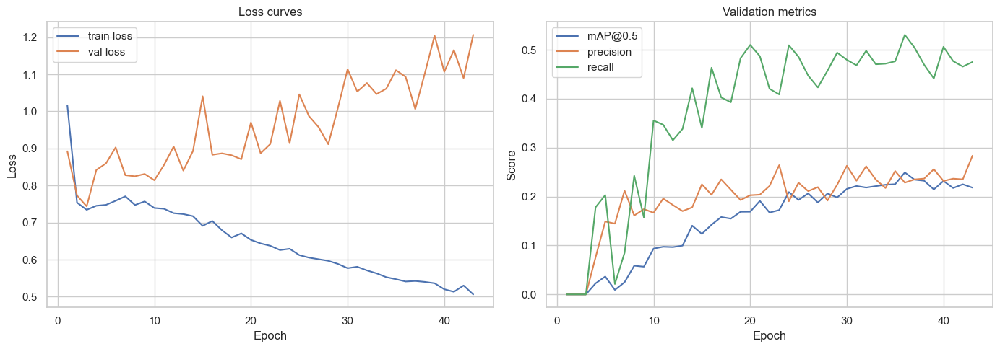

In [12]:
if best_history_df.empty:
    print("History is empty. Run the Optuna training cell first.")
else:
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    axes[0].plot(best_history_df["epoch"], best_history_df["train_loss"], label="train loss")
    axes[0].plot(best_history_df["epoch"], best_history_df["val_loss"], label="val loss")
    axes[0].set_title("Loss curves")
    axes[0].set_xlabel("Epoch")
    axes[0].set_ylabel("Loss")
    axes[0].legend()

    axes[1].plot(best_history_df["epoch"], best_history_df["map50"], label="mAP@0.5")
    axes[1].plot(best_history_df["epoch"], best_history_df["precision"], label="precision")
    axes[1].plot(best_history_df["epoch"], best_history_df["recall"], label="recall")
    axes[1].set_title("Validation metrics")
    axes[1].set_xlabel("Epoch")
    axes[1].set_ylabel("Score")
    axes[1].legend()
    plt.tight_layout()
    plt.show()


## Evaluation on held-out data

Load the best Optuna checkpoint and compute detection metrics on the validation and test splits.


In [13]:
if not BEST_MODEL_PATH.exists():
    raise FileNotFoundError("Training has not produced a checkpoint yet — run the Optuna cell above.")

checkpoint = torch.load(BEST_MODEL_PATH, map_location=device)
best_model = build_model_instance()
best_model.load_state_dict(checkpoint["model_state"])
best_model.to(device)

val_metrics = evaluate_detector(best_model, val_loader, device, score_threshold=EVAL_SCORE_THRESHOLD)
test_metrics = evaluate_detector(best_model, test_loader, device, score_threshold=EVAL_SCORE_THRESHOLD)

metrics_df = pd.DataFrame([val_metrics, test_metrics], index=["val", "test"])
metrics_df


Eval:   0%|          | 0/10 [00:00<?, ?it/s]

Eval:   0%|          | 0/10 [00:00<?, ?it/s]

,mAP@0.5,precision,recall,detections_per_image,detection_coverage,mean_score
val,0.249309,0.228447,0.530570,79.0,1.0,0.712266
test,0.305858,0.272975,0.571697,62.0,1.0,0.700263


## Test-time inference visualization

Compare predicted and ground-truth bounding boxes on a random test tile. Predictions are shown in red with objectness scores, and ground truth in green.


Sample test tile: 78099b50-f2b6-4319-b462-f33df2966c45.jpg


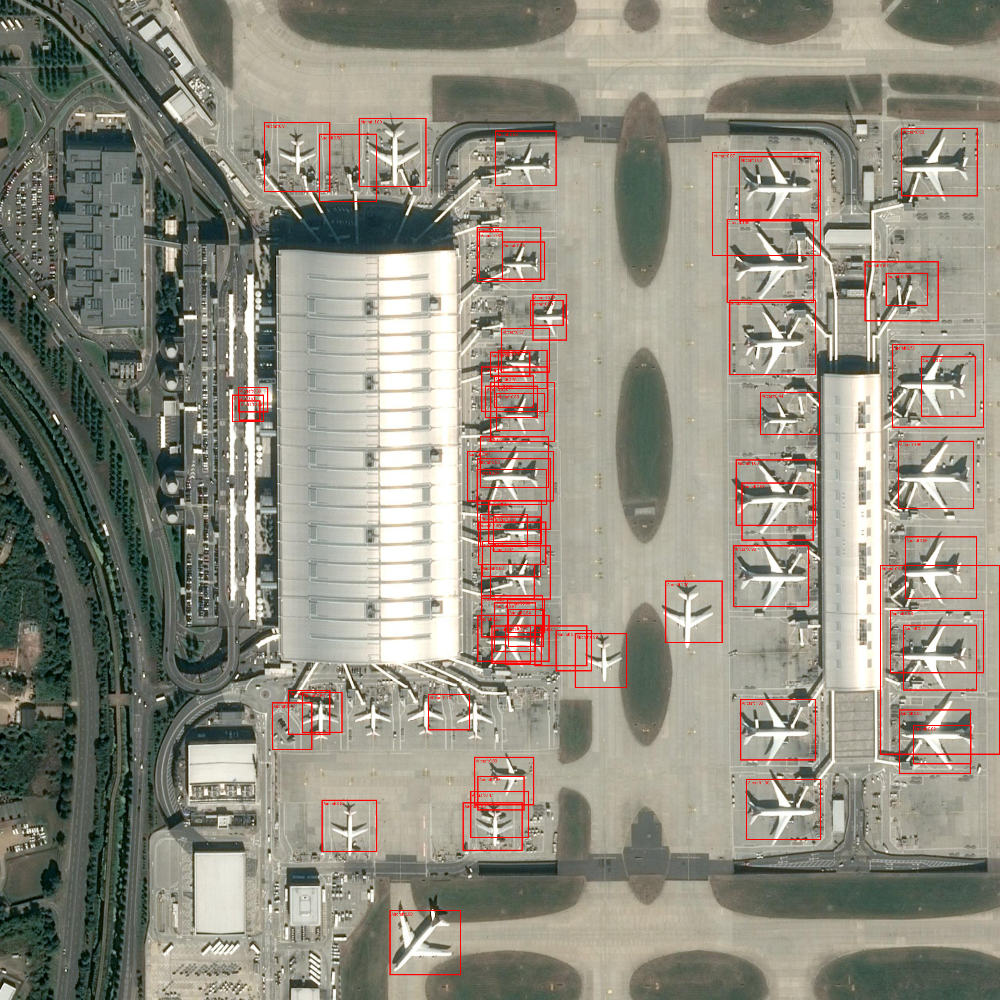

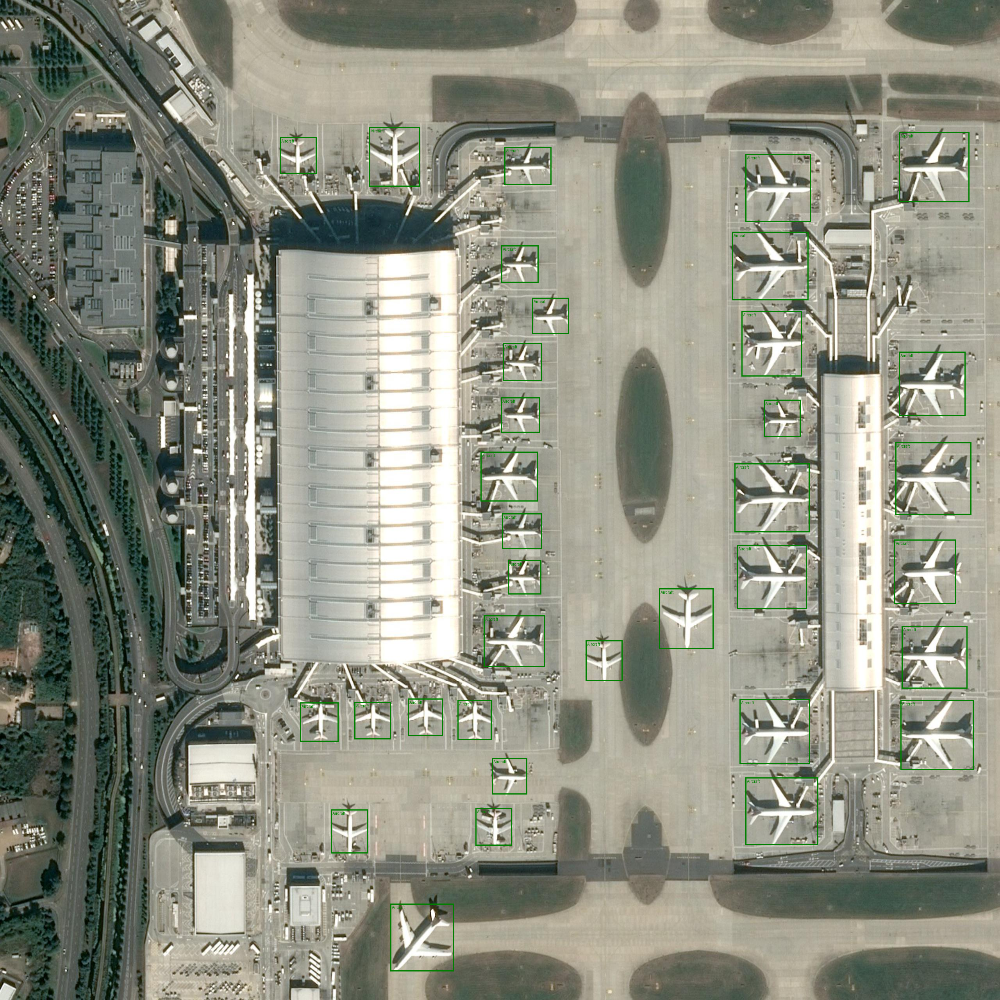

In [21]:
if "best_model" not in globals():
    if not BEST_MODEL_PATH.exists():
        raise FileNotFoundError("No trained model found. Run the training/eval cells first.")
    checkpoint = torch.load(BEST_MODEL_PATH, map_location=device)
    best_model = build_model_instance()
    best_model.load_state_dict(checkpoint["model_state"])
    best_model.to(device)

best_model.eval()

sample_image_id = random.choice(splits["test"])
sample_record = records[sample_image_id]
raw_image = Image.open(sample_record.image_path).convert("RGB")
orig_w, orig_h = raw_image.size

input_tensor = raw_image.resize((IMAGE_SIZE, IMAGE_SIZE), Image.BILINEAR)
input_tensor = F.to_tensor(input_tensor)
input_tensor = F.normalize(input_tensor, mean=ALEXNET_MEAN, std=ALEXNET_STD).unsqueeze(0).to(device)

with torch.no_grad():
    prediction = best_model(input_tensor)[0]

keep = prediction["scores"] >= EVAL_SCORE_THRESHOLD
pred_boxes = prediction["boxes"][keep].cpu().clone()
pred_scores = prediction["scores"][keep].cpu().tolist()
pred_labels = prediction["labels"][keep].cpu().tolist()

scale_x = orig_w / IMAGE_SIZE
scale_y = orig_h / IMAGE_SIZE
pred_boxes[:, [0, 2]] *= scale_x
pred_boxes[:, [1, 3]] *= scale_y

pred_vis = raw_image.copy()
draw_pred = ImageDraw.Draw(pred_vis)
for box, score, label in zip(pred_boxes, pred_scores, pred_labels):
    box = box.tolist()
    draw_pred.rectangle(box, outline="red", width=3)
    class_name = IDX_TO_CLASS.get(label, "Aircraft")
    draw_pred.text((box[0] + 4, box[1] + 4), f"{class_name} {score:.2f}", fill="red")

gt_vis = raw_image.copy()
draw_gt = ImageDraw.Draw(gt_vis)
for box, label in zip(sample_record.boxes, sample_record.labels):
    box = box.tolist()
    draw_gt.rectangle(box, outline="green", width=3)
    class_name = IDX_TO_CLASS.get(int(label), "Aircraft")
    draw_gt.text((box[0] + 4, box[1] + 4), class_name, fill="green")

print(f"Sample test tile: {sample_image_id}")
display.display(pred_vis)
display.display(gt_vis)
